# Assignment 4: VAT and iVAT Algorithms

### *Description*
The goal of this assignment was to apply the Visual Assessment for Tendency (VAT) and Improved Vat (iVAT) algorithms to some datasets. The VAT and iVAT algorithms provide visuals that we can use to determine the appropriate number of datasets for a clustering algorithm.

### *Technical Details*
The VAT and iVAT algorithm take the dissimilarity vectors of the datapoints and reorder them by grouping distances that are close together. The resulting re-arranged values can be plotted on a heatmap to provide a visual indication of the number of clusters we should input in our clustering algorithm, or can prevent us from wasting time clustering data that has no clusters. The iVAT algorithm improves on VAT by providing a potentially cleaner visualization of the re-arranged dissimilarity.

Below is the MATLAB code used for getting the datasets, applying VAT and iVAT, and plotting the results.

```
close all;
clear all;
clc;

datasets = LoadDataSets();

for i=1:length(datasets)
    dataset = datasets{i};
    R1 = dataset(:, 1);
    C1 = dataset(:, 2);
    datasetString = ['Dataset ' num2str(i)];
    try
        % Prep Figure
        ss = get(0,'screensize');
        fig = figure();
        set(fig, 'visible', 'off');
        fig.Position = [0, 0, ss(3), ss(4)];
        set(gca,'XColor', 'none','YColor','none')
        set(gca,'XTickLabel',[]);
        set(gca,'YTickLabel',[]);
        disableDefaultInteractivity(gca);
        
        % Datapoints
        s1 = subplot(2, 2, 1);
        s1.Position = [.05, .55, .4, .4];
        plot0 = plot(R1, C1, 'xk');
        title([datasetString ' Datapoints']);
        
        
        % Distances
        dist = pdist2(dataset, dataset);
        
        s2 = subplot(2, 2, 2);
        s2.Position = [.55, .55, .4, .4];
        set(s2,'xtick',[],'ytick',[])
        disableDefaultInteractivity(s2);
        
        heat0 = heatmap(dist);
        title([datasetString ' Dist Plot']);
        heat0.GridVisible = 'off';
        colormap('autumn');
        heat0.XDisplayLabels = nan(size(heat0.XDisplayData));
        heat0.YDisplayLabels = nan(size(heat0.YDisplayData));
        
        % VAT
        [RV,C,I,RI] = VAT(dist);
        RV = RV ./ max(max(RV));
        
        s3 = subplot(2, 2, 3);
        s3.Position = [.05, .05, .4, .4];
        disableDefaultInteractivity(gca);
        heat1 = heatmap(RV);
        title([datasetString ' VAT']);
        heat1.GridVisible = 'off';
        colormap('autumn');
        heat1.XDisplayLabels = nan(size(heat1.XDisplayData));
        heat1.YDisplayLabels = nan(size(heat1.YDisplayData));
        
        
        % iVAT
        [RiV,RV] = iVAT(dist, true);
        RiV = RiV ./ max(max(RiV));
        
        s4 = subplot(2, 2, 4);
        s4.Position = [.55, .05, .4, .4];
        disableDefaultInteractivity(gca);
        heat2 = heatmap(RiV);
        title([datasetString ' iVAT']);
        heat2.GridVisible = 'off';
        colormap('autumn');
        heat2.XDisplayLabels = nan(size(heat2.XDisplayData));
        heat2.YDisplayLabels = nan(size(heat2.YDisplayData));
        
        saveas(fig, ['dataset_' num2str(i) '_results.png']);
    catch exception
        i
        size(dataset)
        exception
    end
end
```

The results for each of the datasets are shown below.

Dataset 1


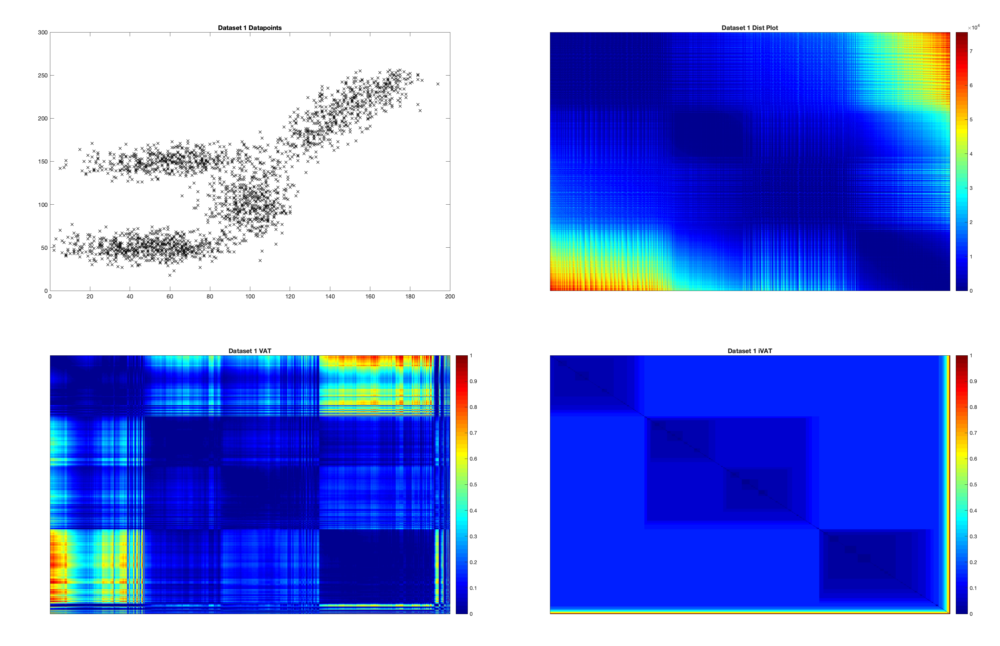

Dataset 2


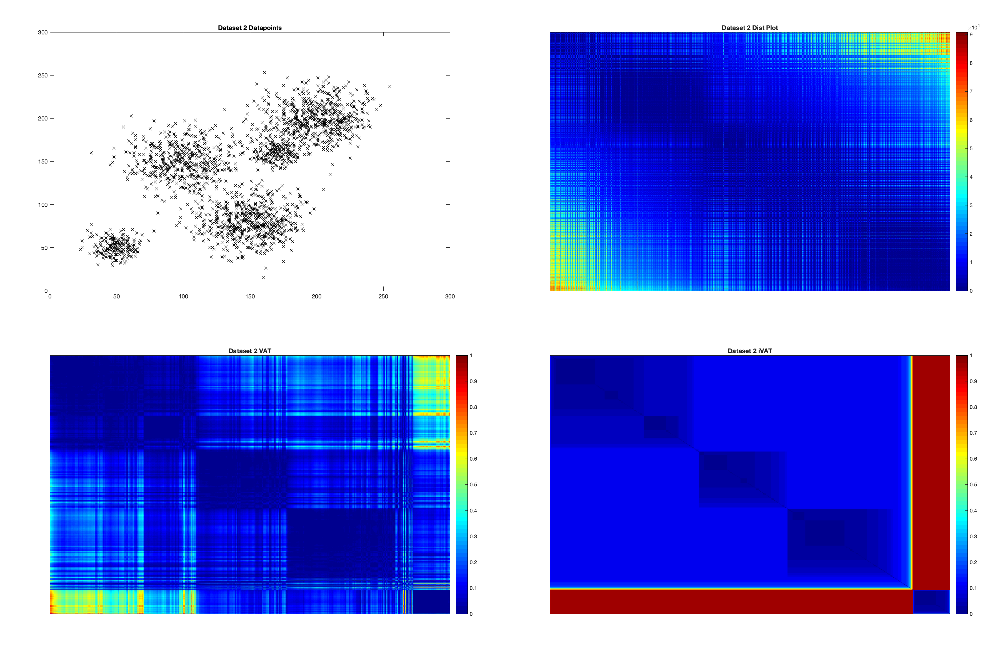

Dataset 3
No image found for Dataset 3
Dataset 4


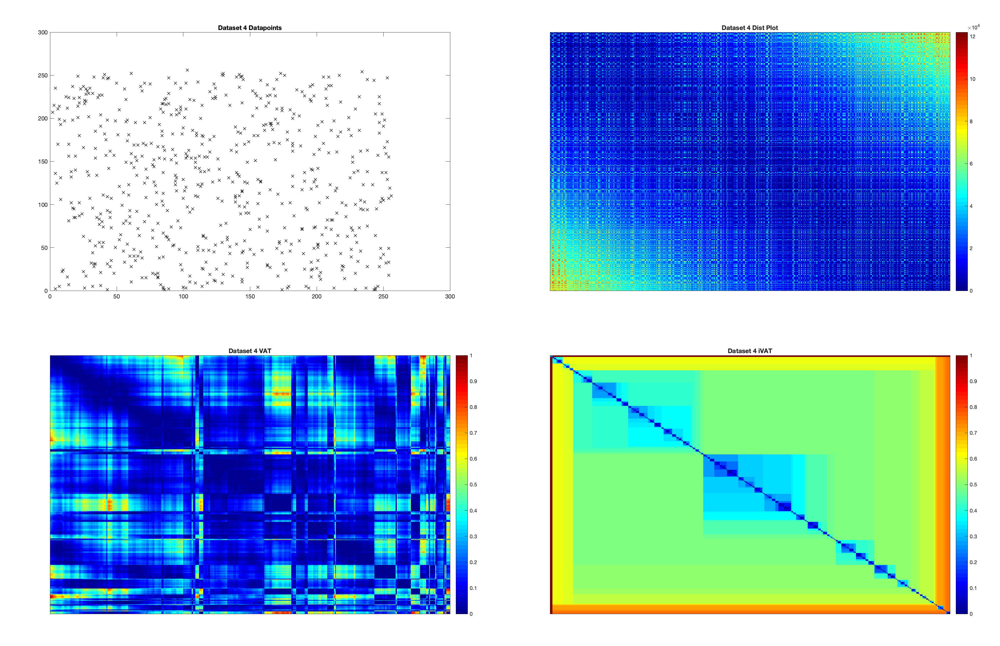

Dataset 5


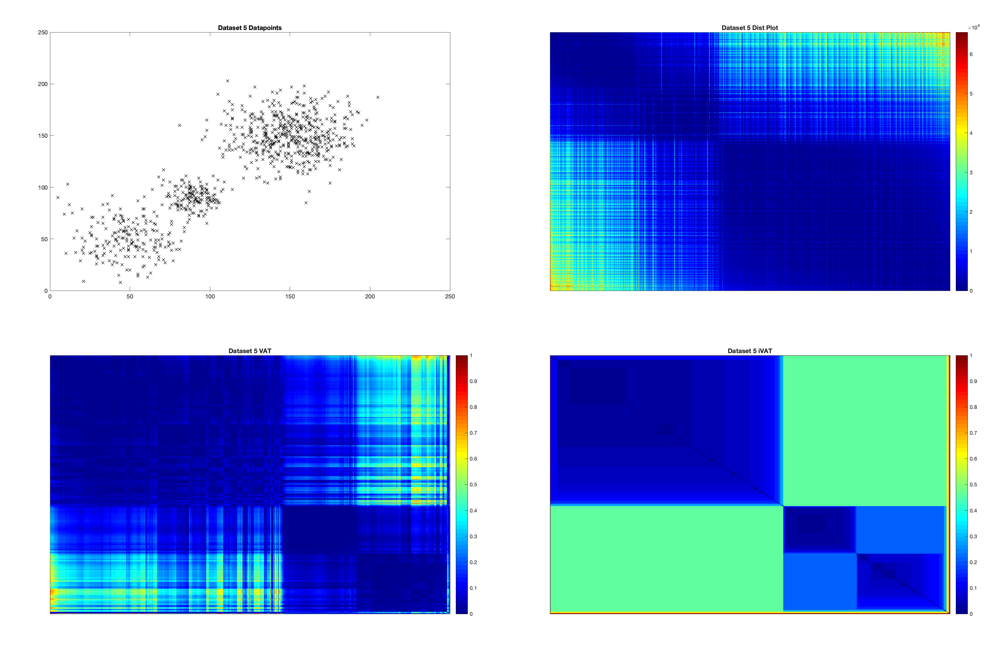

Dataset 6


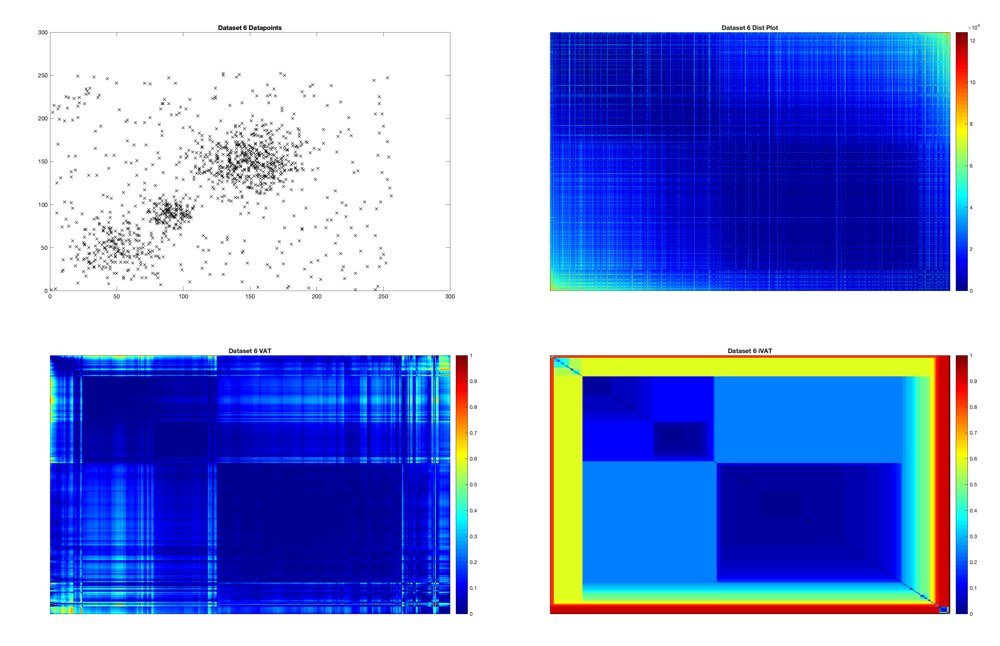

Dataset 7


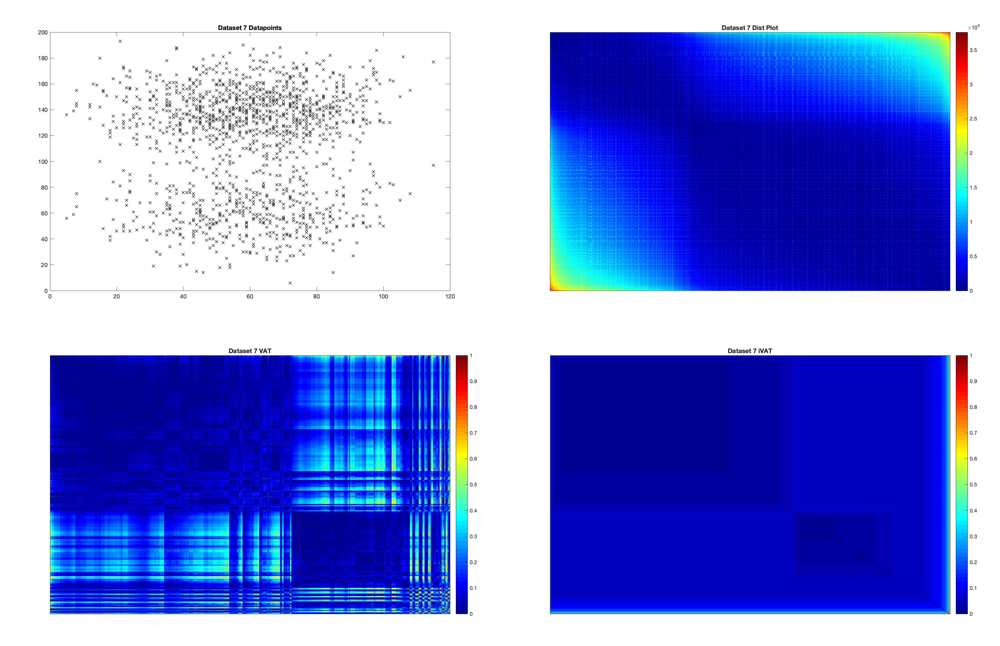

Dataset 8


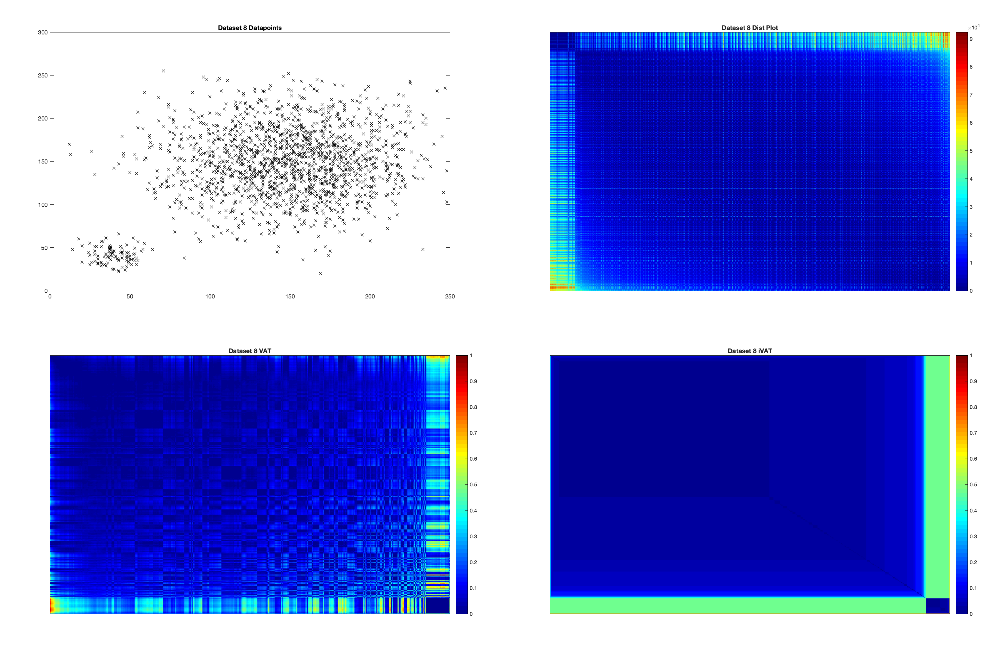

Dataset 9


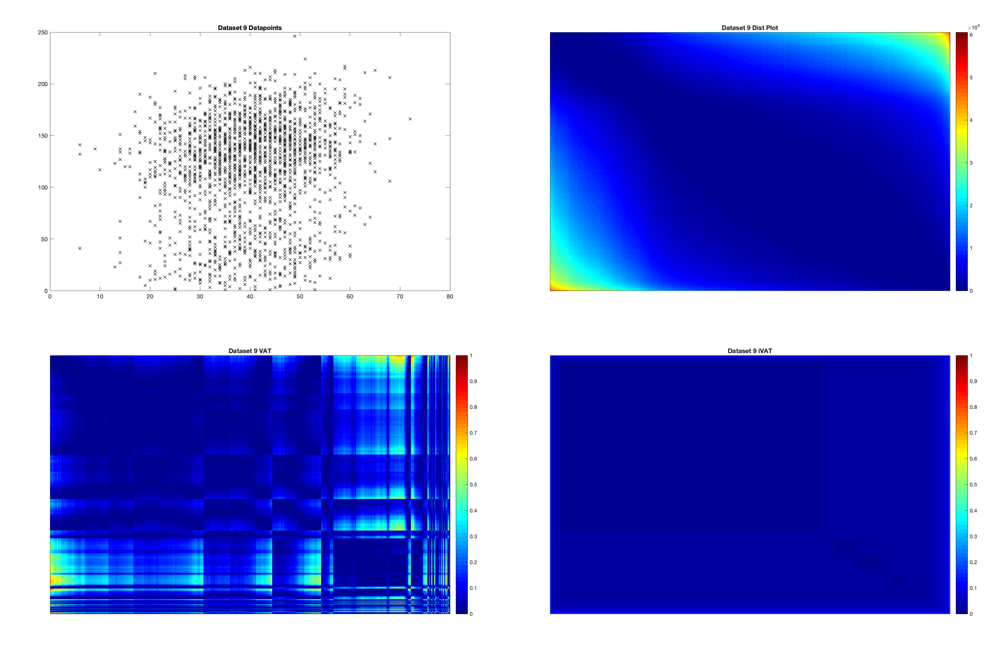

Dataset 10


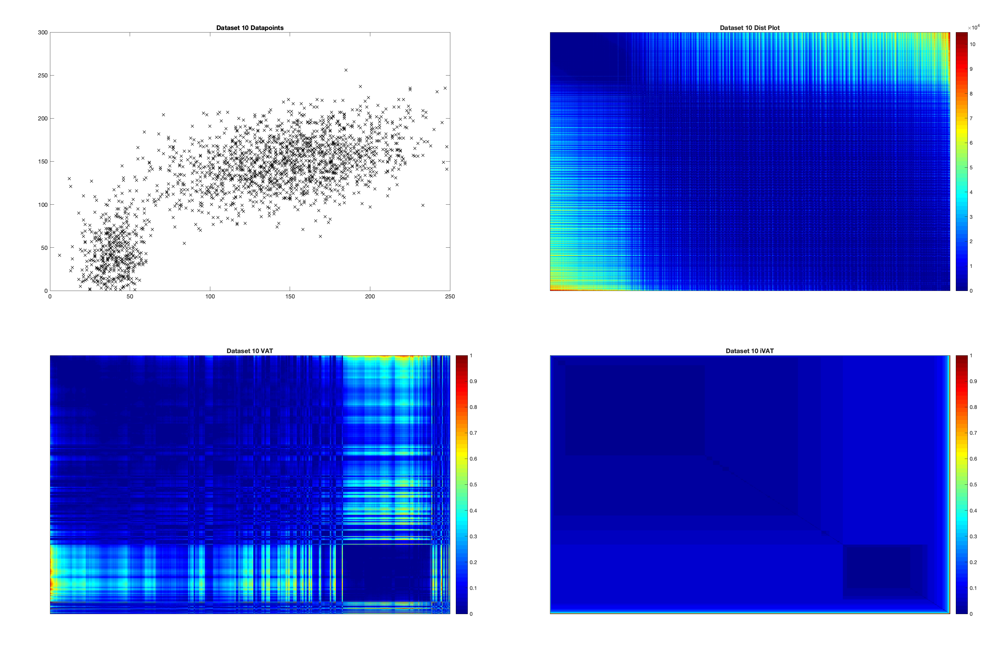

Dataset 11


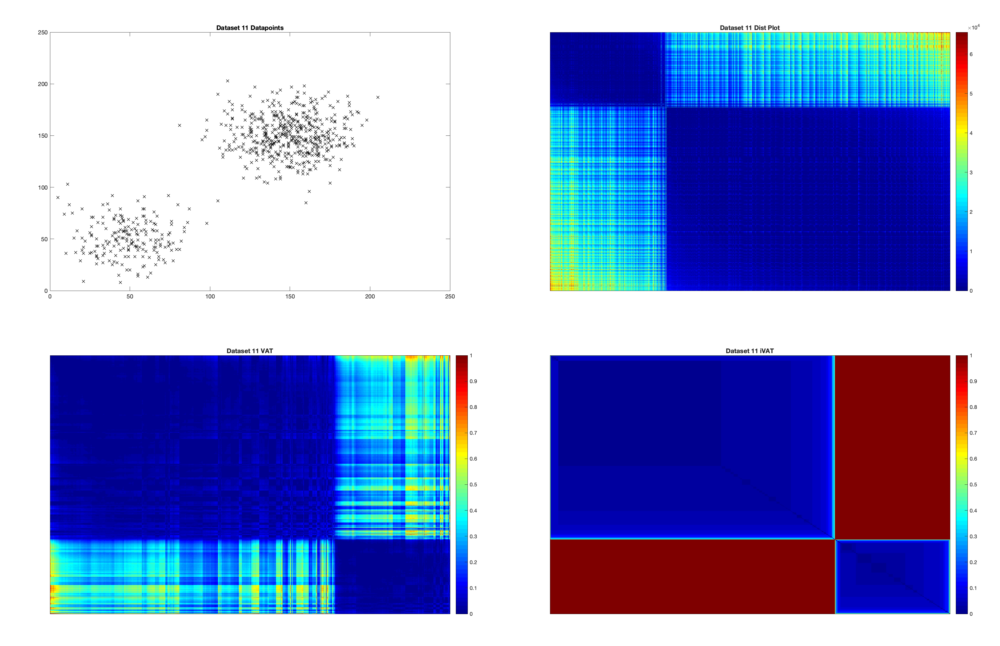

Dataset 12


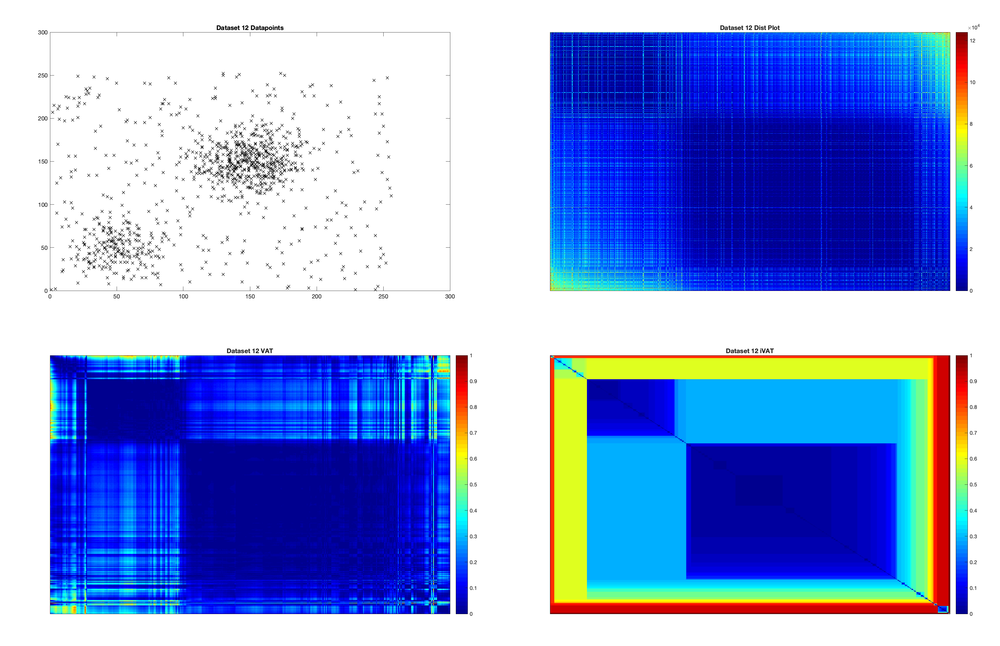

In [5]:
from IPython.display import Image, display

for i in range(1, 13):
    try:
        print(f'Dataset {i}')
        display(Image(filename=f'./dataset_{i}_results.png') )
    except:
        print(f'No image found for Dataset {i}')



### *Results*

The results are very clear to me. We can see that VAT performs well on datasets that are clusterable, although there can be some ambiguity on the number of clusters if there is overlap in the data. This is expected. iVAT performs extremely well with very little ambiguity. The best example of this is dataset 6, where it is clear that there is one definite cluster, and a second cluster that could potentially be broken down into two smaller clusters. Being able to see these major and minor clusters so clearly makes iVAT very impressive to me.

The algorithm failed for dataset 3 because there aren't enough data points. I feel that using the algorithms on a couple datapoints doesn't make sense anyway.

*Note: Using a colormap with high variation is very helpful in VAT visualization.*

### *Conclusion*

Although VAT is still a viable method for determining the appropriate number of clusters we should use for our algorithm (or if we should use it at all), iVAT's performance is above and beyond and leads much less room for error and ambiguity. That being said, VAT and iVAT both become intractable for extremely large datasets, so more sophisticated methods would have to be used for big data analysis.
